# dermaCAP EDA

In [2]:
from pathlib import Path
import os, textwrap
import numpy as np
import pandas as pd
from PIL import Image, UnidentifiedImageError
import matplotlib.pyplot as plt

In [3]:
BASE_DIR = Path("/workspace/clip_xai/dermaCAP")
CSV_PATH = BASE_DIR / "dermaCAP_v1" / "dermaCAP_v1.csv"
IMG_ROOT = BASE_DIR / "dermaCAP_v1" / "dermaCAP_img"

FIGSIZE = (10, 8)      
SAMPLE_FIGSIZE = (12, 8) 
RNG = np.random.default_rng(42)

In [4]:
df = pd.read_csv(CSV_PATH)
assert {"img_path","caption","source","img_name"}.issubset(df.columns)

In [5]:
df["caption_words"] = df["caption"].fillna("").astype(str).str.split().map(len)

In [6]:
w, h, area_mp, f_mb = [], [], [], []
for p in df["img_path"]:
    try:
        with Image.open(p) as im:
            W, H = im.size
        w.append(W); h.append(H); area_mp.append((W*H)/1e6)
    except (FileNotFoundError, UnidentifiedImageError, OSError):
        w.append(np.nan); h.append(np.nan); area_mp.append(np.nan)
    try:
        f_mb.append(os.path.getsize(p)/(1024*1024))
    except (FileNotFoundError, OSError):
        f_mb.append(np.nan)

df["width"], df["height"], df["area_mp"], df["file_mb"] = w, h, area_mp, f_mb

In [7]:
def smart_bins(series: pd.Series, max_bins: int = 80):
    arr = series.dropna().to_numpy()
    if arr.size <= 1:
        return np.array([0, 1])
    try:
        edges = np.histogram_bin_edges(arr, bins="fd")
    except Exception:
        edges = np.histogram_bin_edges(arr, bins="sturges")
    edges = np.unique(edges)
    if edges.size > max_bins:
        idx = np.linspace(0, edges.size-1, max_bins).round().astype(int)
        edges = edges[idx]
        edges[0], edges[-1] = arr.min(), arr.max()
    if edges.size < 2:
        m, M = arr.min(), arr.max()
        edges = np.array([m-0.5, M+0.5]) if m == M else np.linspace(m, M, min(20, max_bins))
    return edges

def overlay_hist_by_source(series_name: str, title: str, xlabel: str):
    data = df[[series_name, "source"]].dropna()
    bins = smart_bins(data[series_name])
    plt.figure(figsize=(10, 8))
    for src, d in df.groupby("source"):
        plt.hist(d[series_name].dropna(), bins=bins, alpha=0.5, label=src)
    plt.title(title); plt.xlabel(xlabel); plt.ylabel("Частота")
    plt.legend(); plt.tight_layout(); plt.show()

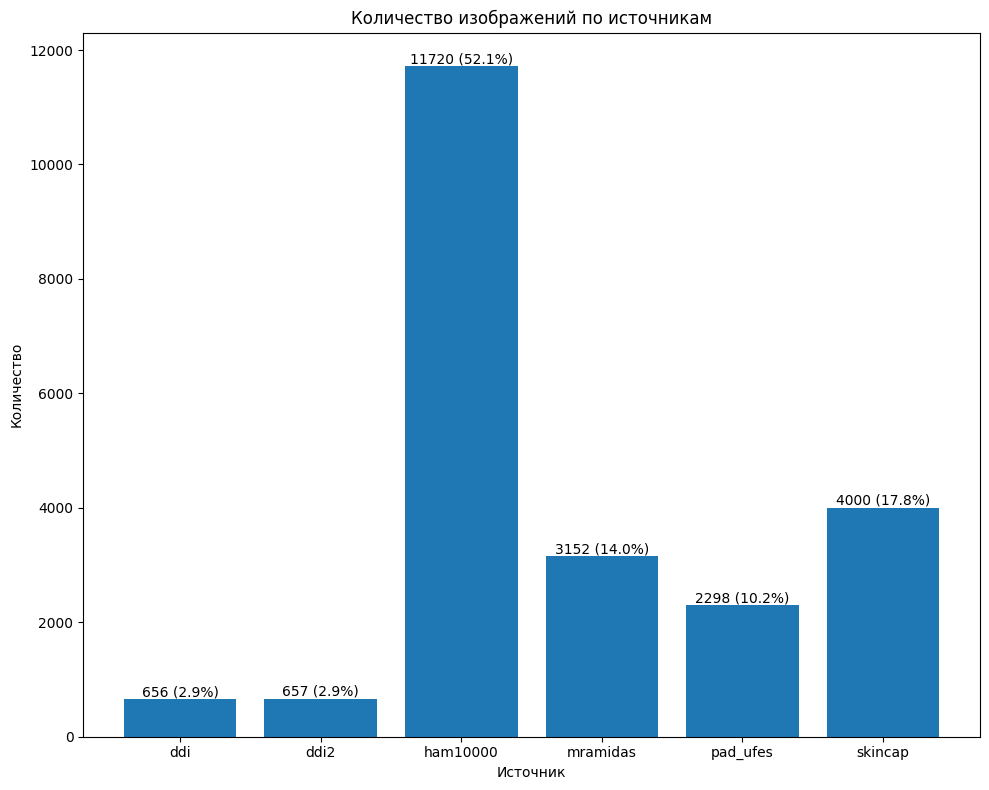

In [8]:
counts = df["source"].value_counts().sort_index()
perc = counts / counts.sum() * 100

plt.figure(figsize=(10, 8))
plt.bar(counts.index.astype(str), counts.values)
for i, (c, p) in enumerate(zip(counts.values, perc.values)):
    plt.text(i, c, f"{c} ({p:.1f}%)", ha="center", va="bottom")
plt.title("Количество изображений по источникам")
plt.xlabel("Источник"); plt.ylabel("Количество")
plt.tight_layout(); plt.show()

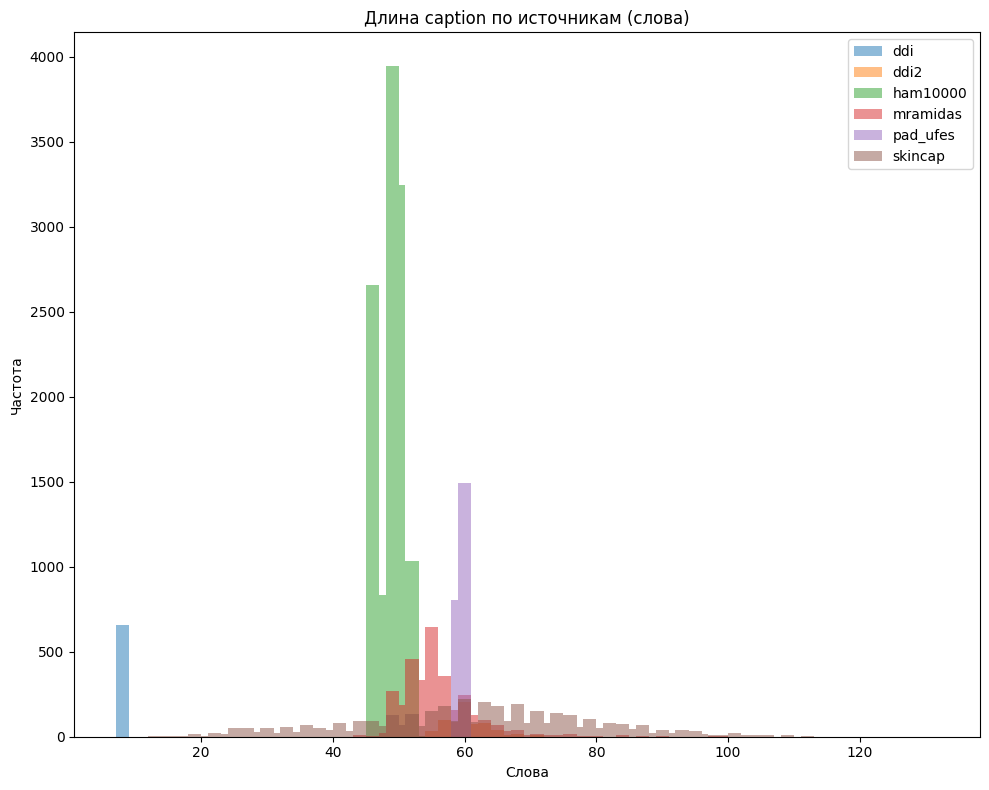

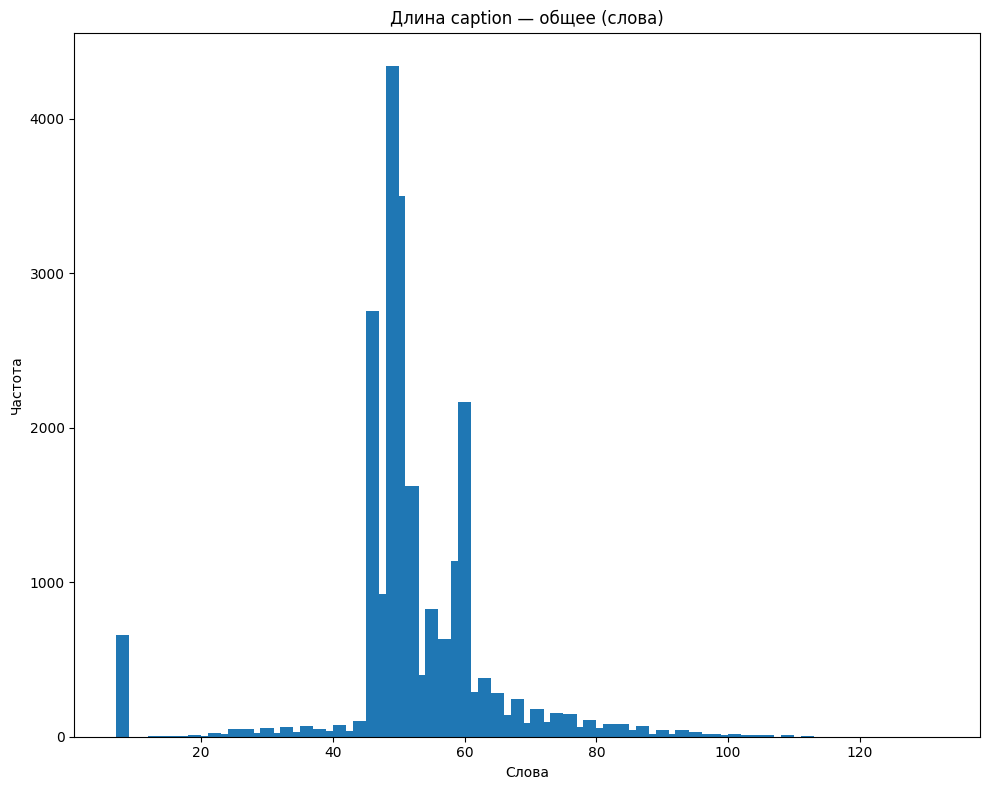

In [9]:
overlay_hist_by_source("caption_words", "Длина caption по источникам (слова)", "Слова")

plt.figure(figsize=(10, 8))
plt.hist(df["caption_words"].dropna(), bins=smart_bins(df["caption_words"]))
plt.title("Длина caption — общее (слова)")
plt.xlabel("Слова"); plt.ylabel("Частота")
plt.tight_layout(); plt.show()

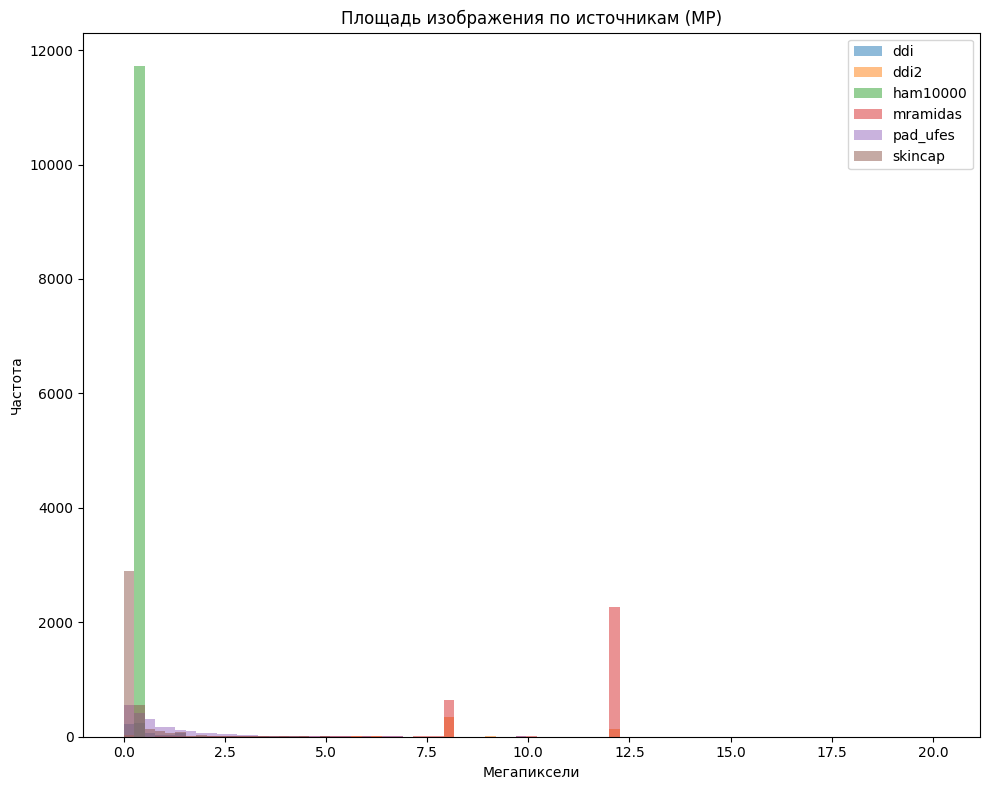

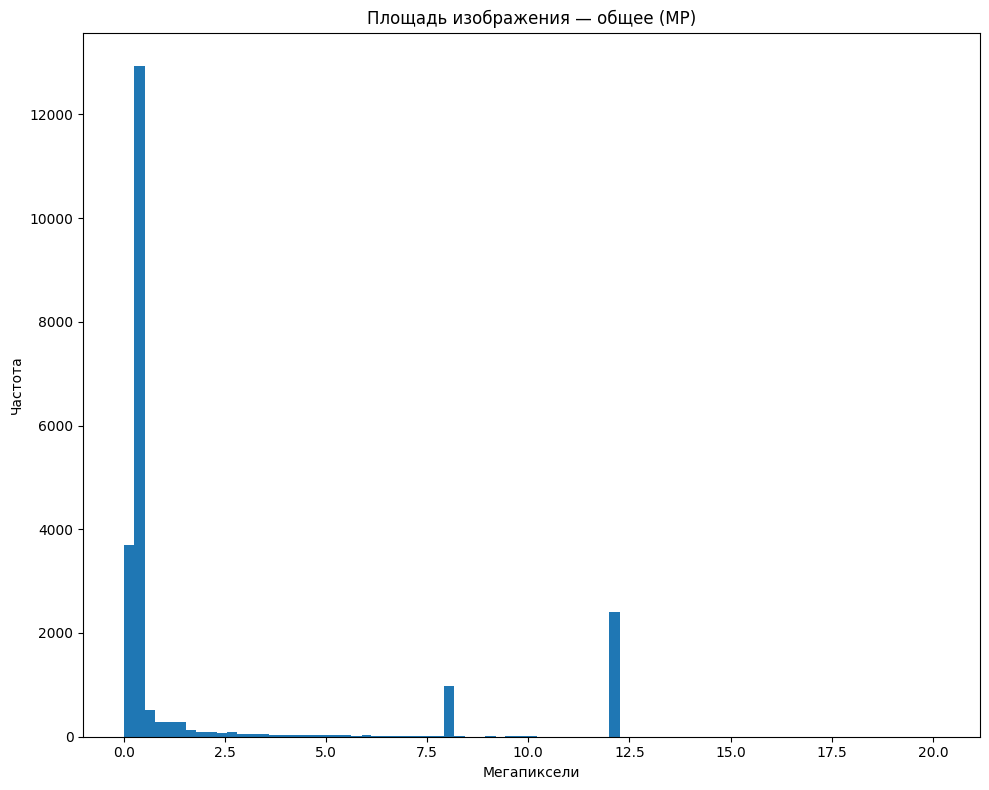

In [10]:
overlay_hist_by_source("area_mp", "Площадь изображения по источникам (MP)", "Мегапиксели")

plt.figure(figsize=(10, 8))
plt.hist(df["area_mp"].dropna(), bins=smart_bins(df["area_mp"]))
plt.title("Площадь изображения — общее (MP)")
plt.xlabel("Мегапиксели"); plt.ylabel("Частота")
plt.tight_layout(); plt.show()

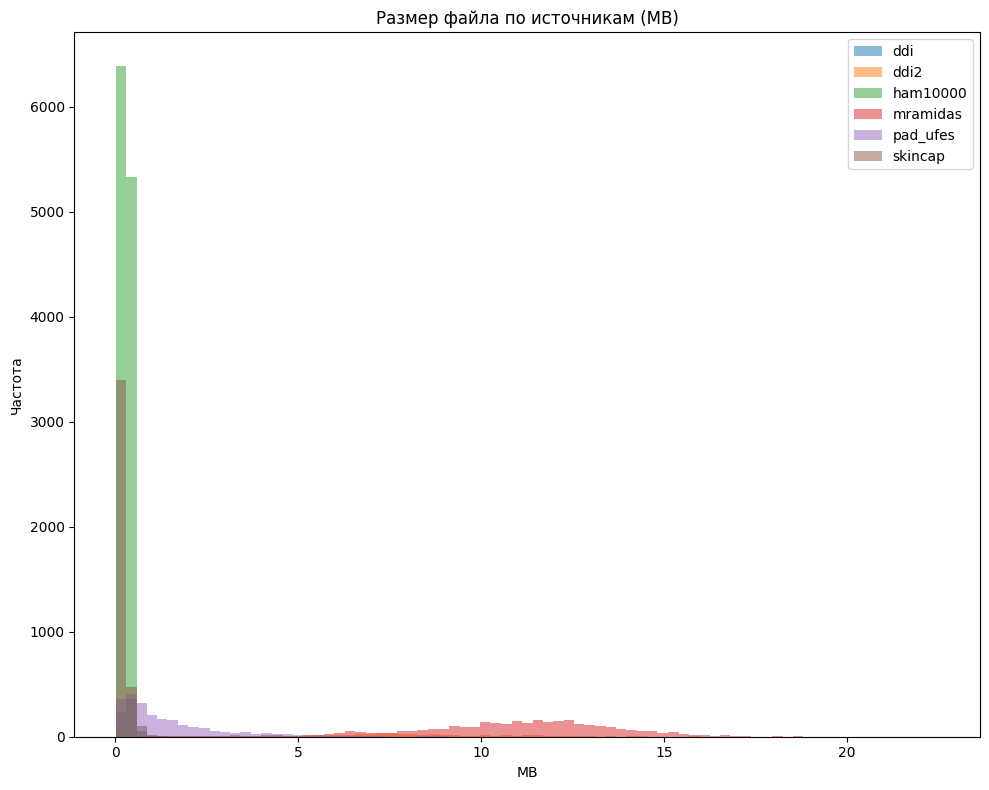

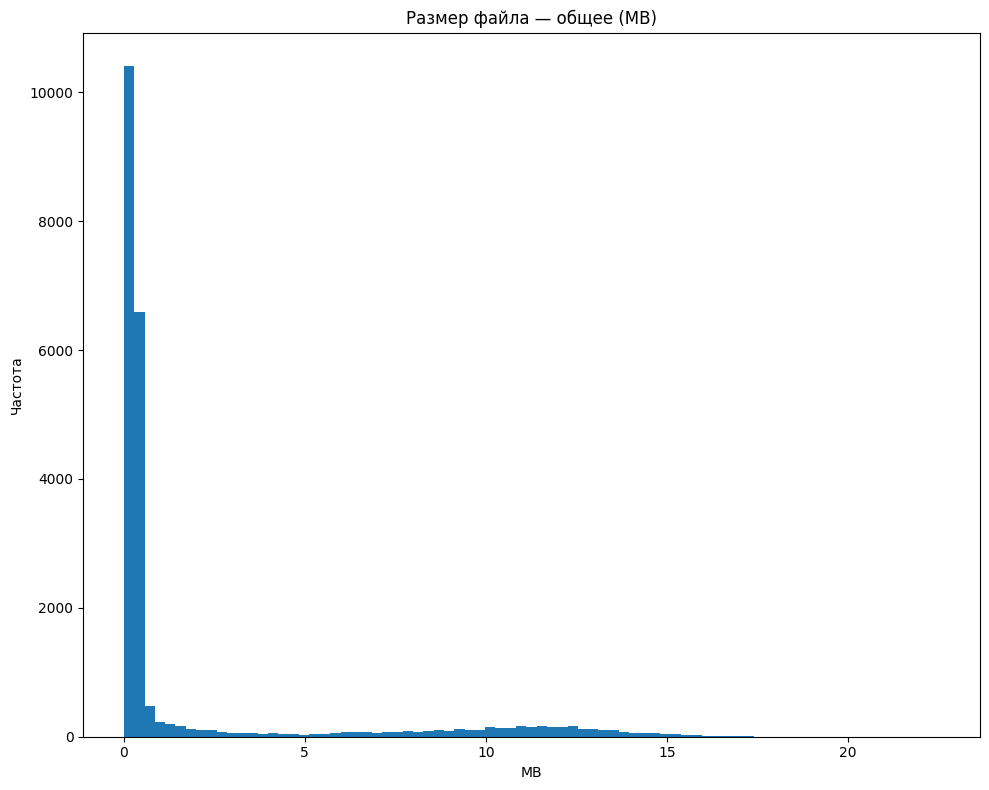

In [11]:
overlay_hist_by_source("file_mb", "Размер файла по источникам (MB)", "MB")

plt.figure(figsize=(10, 8))
plt.hist(df["file_mb"].dropna(), bins=smart_bins(df["file_mb"]))
plt.title("Размер файла — общее (MB)")
plt.xlabel("MB"); plt.ylabel("Частота")
plt.tight_layout(); plt.show()

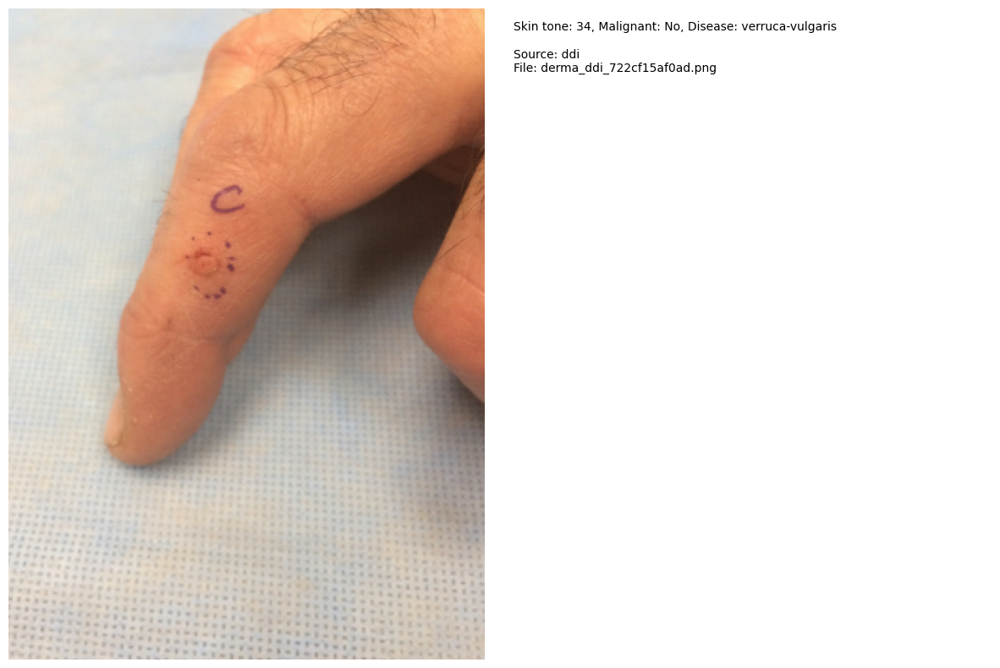

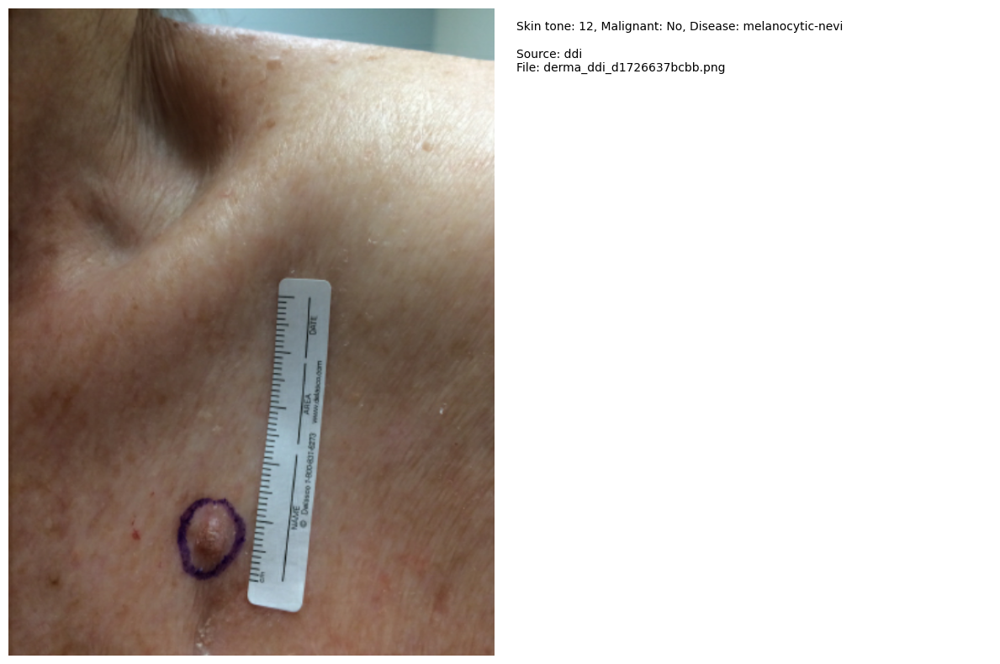

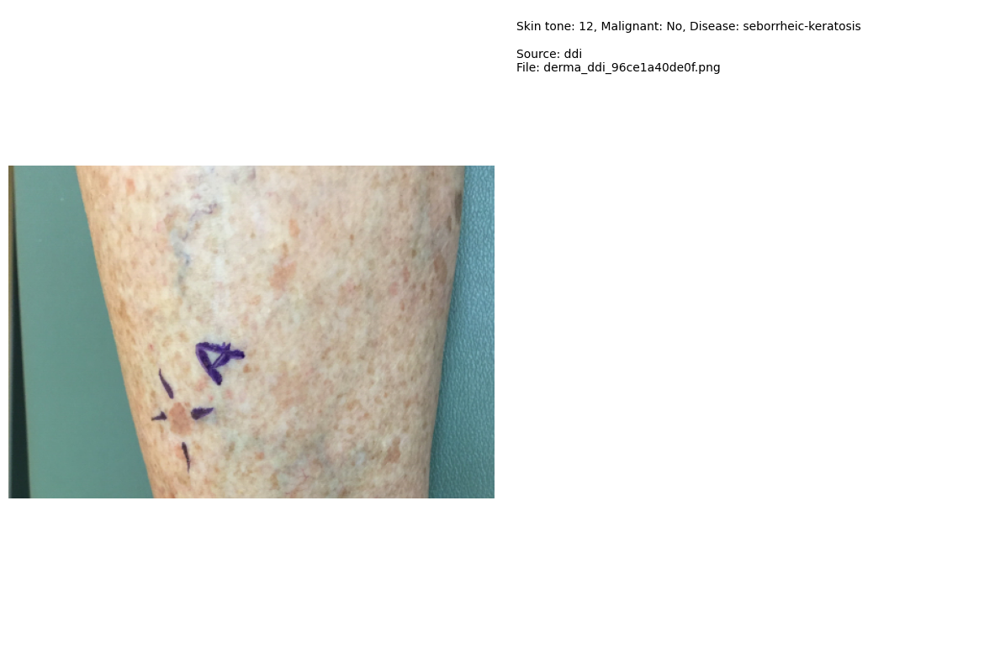

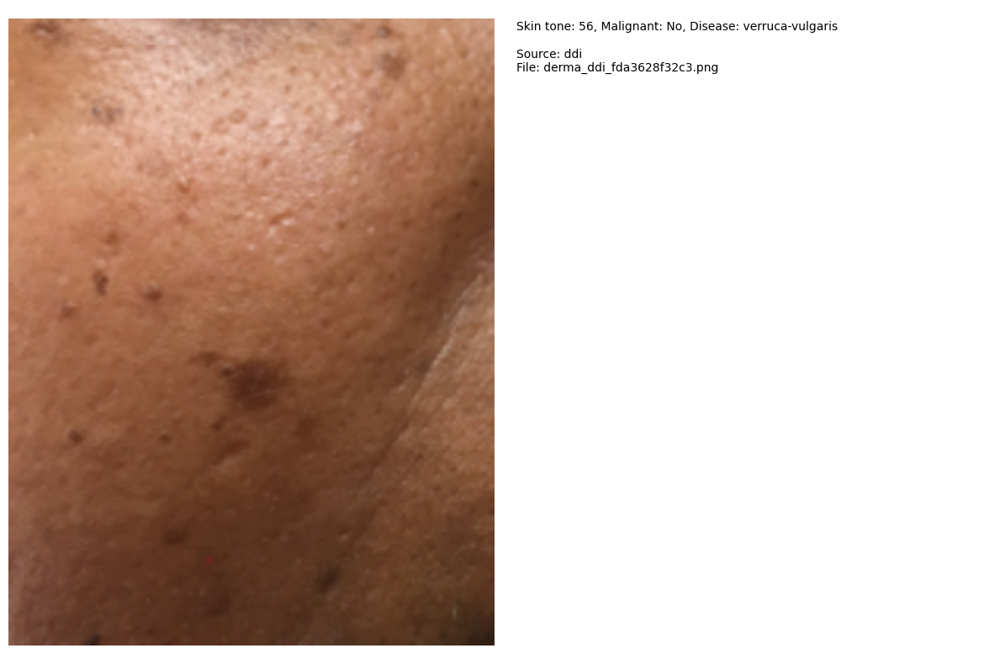

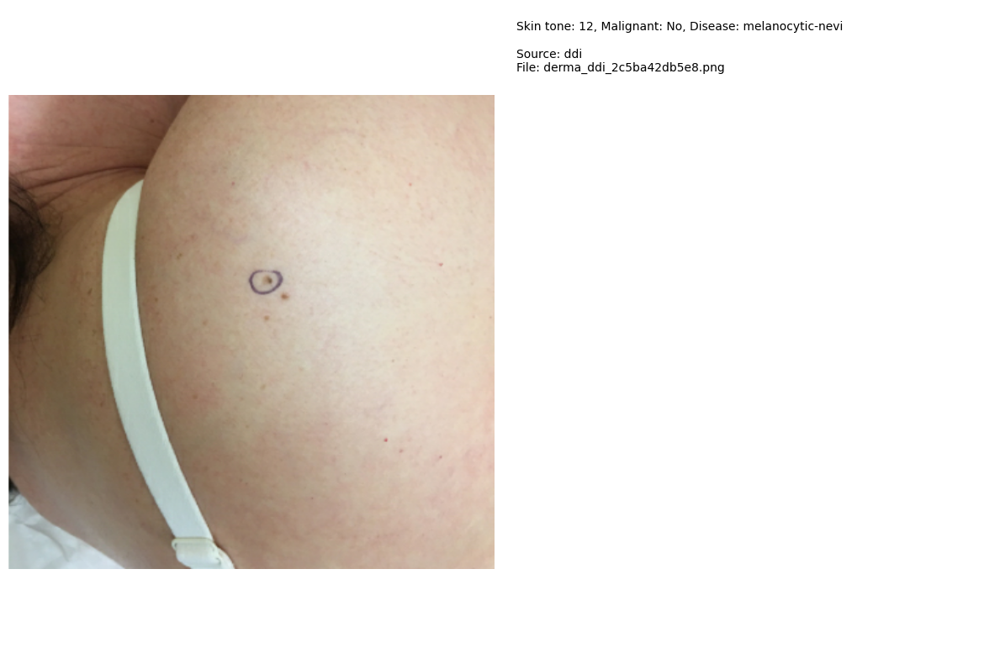

...

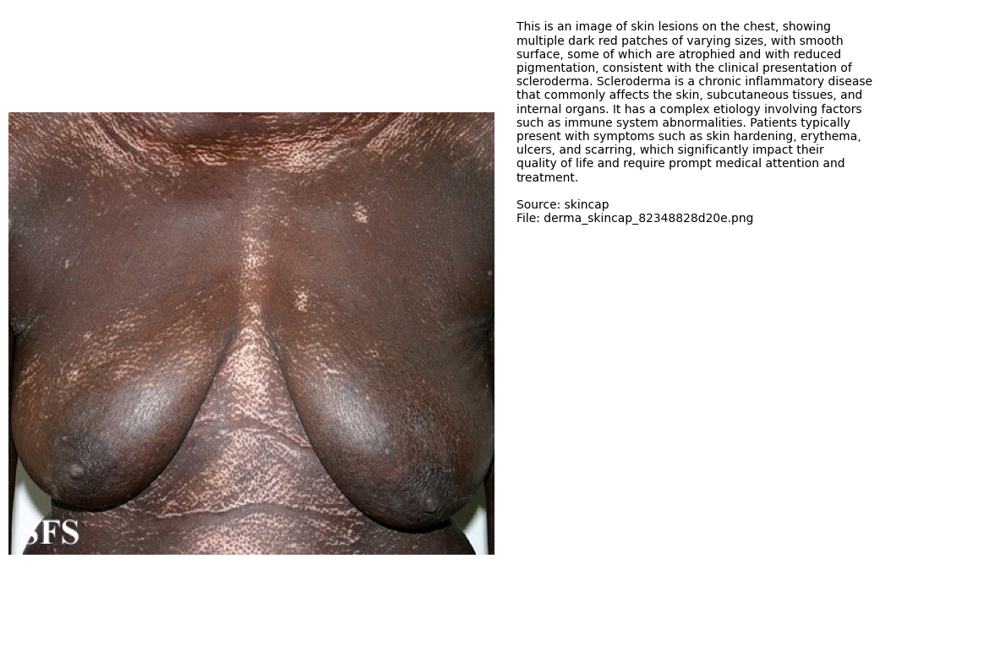

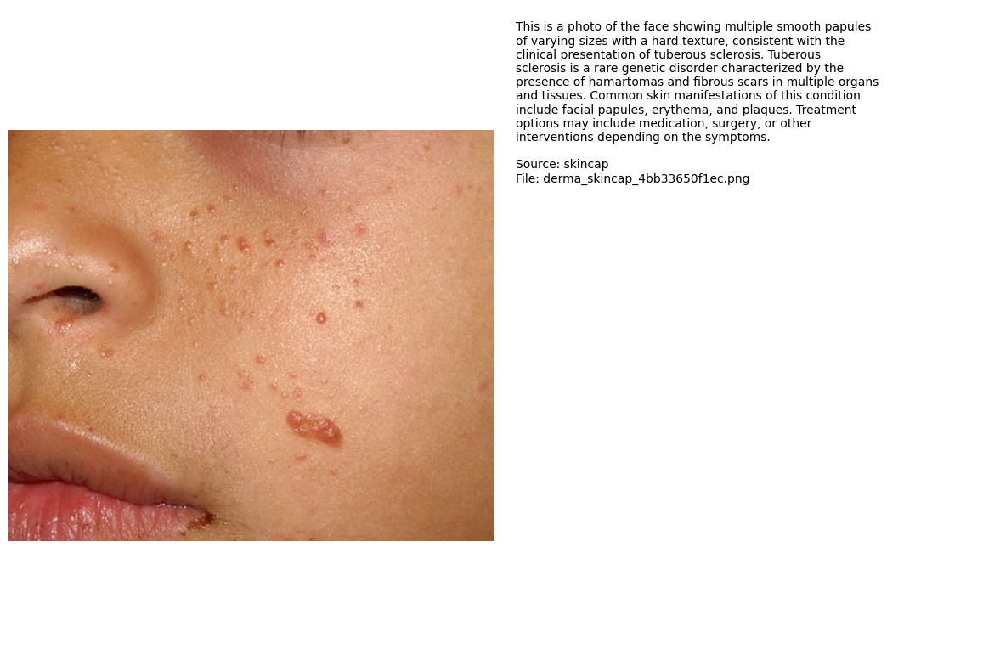

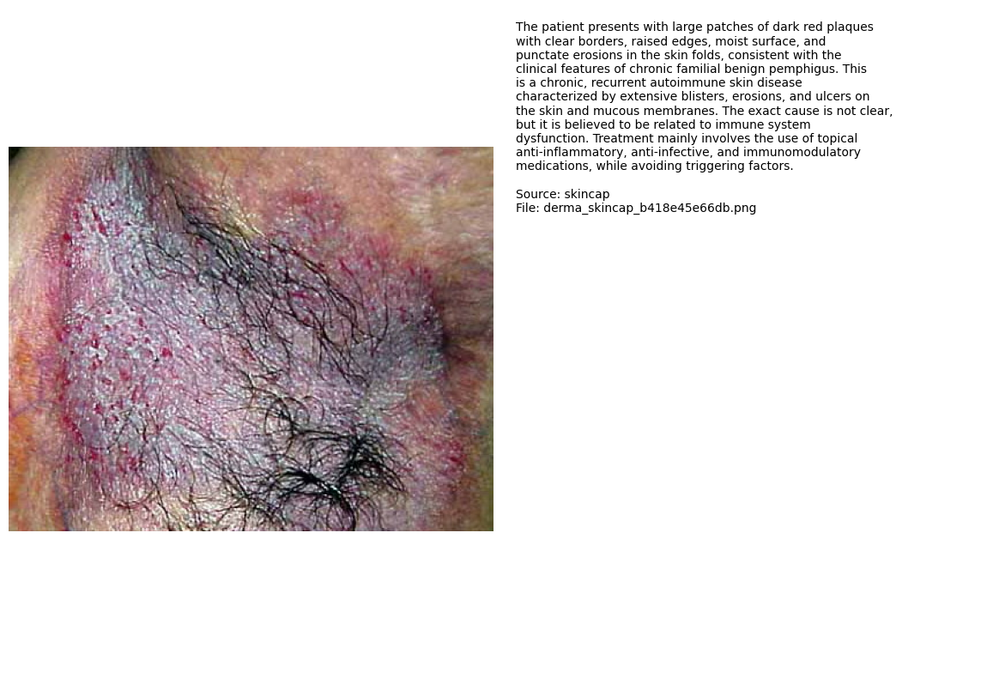

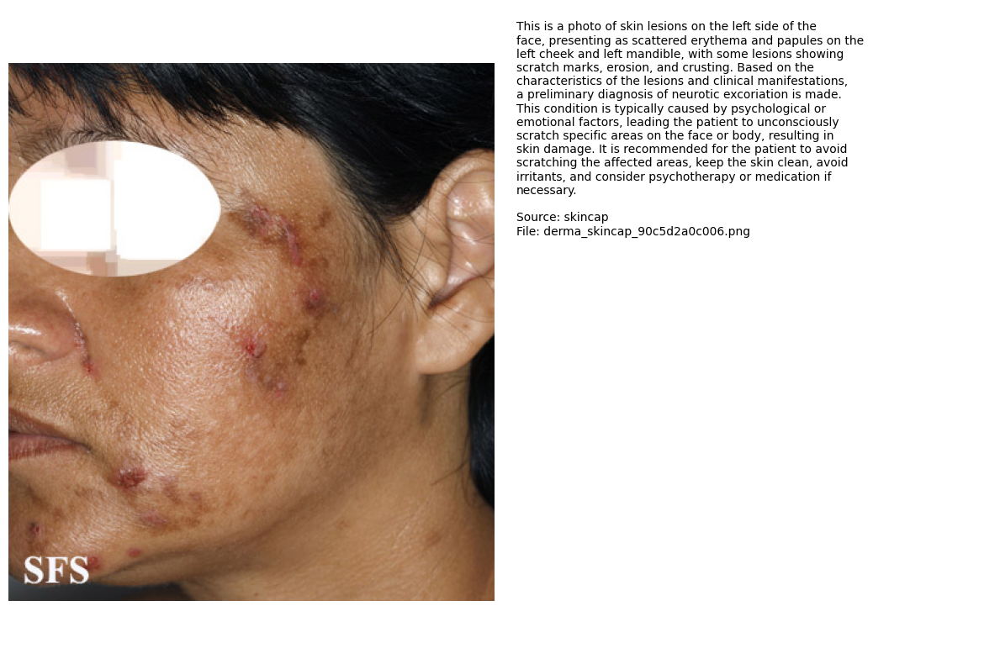

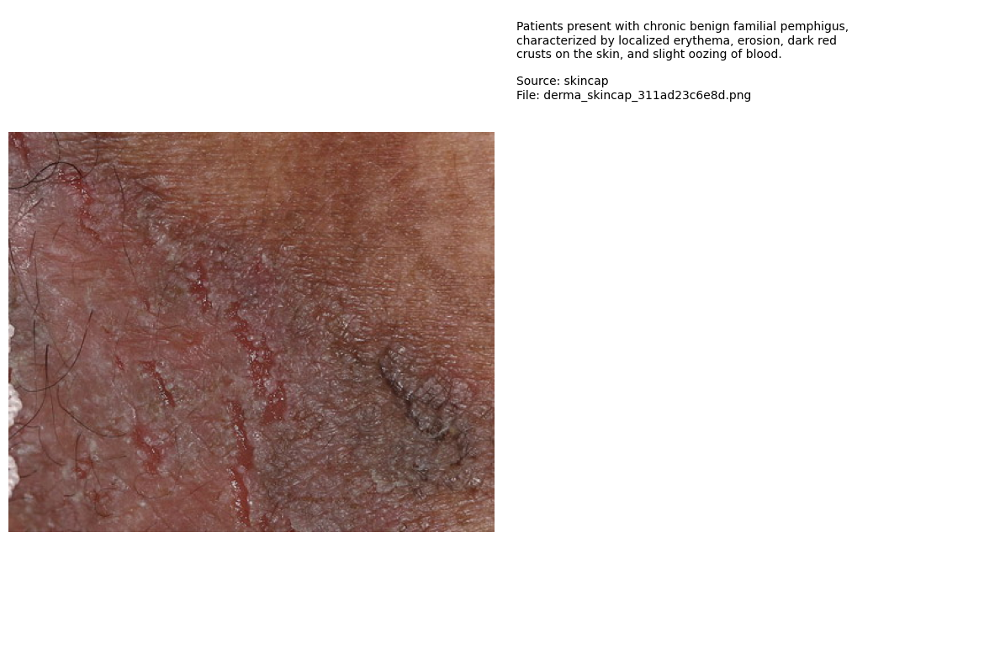

In [12]:
for src, d in df.groupby("source"):
    n = min(5, len(d))
    if n == 0:
        continue
    picks = RNG.choice(d.index.values, size=n, replace=False)
    for idx in picks:
        row = df.loc[idx]
        fig, axes = plt.subplots(1, 2, figsize=SAMPLE_FIGSIZE)  # 2 панели
        ax_img, ax_txt = axes

        try:
            with Image.open(row["img_path"]) as im:
                ax_img.imshow(im)
            ax_img.axis("off")
        except Exception as e:
            ax_img.text(0.5, 0.5, f"Не открыть:\n{row['img_path']}\n{e}", ha="center", va="center")
            ax_img.axis("off")

        ax_txt.axis("off")
        cap_wrapped = textwrap.fill(str(row["caption"]), width=60)
        info = f"Source: {src}\nFile: {row['img_name']}"
        ax_txt.text(0.02, 0.98, cap_wrapped + "\n\n" + info, ha="left", va="top", wrap=True)

        plt.tight_layout(); plt.show()

In [13]:
n_images   = int(df["img_path"].notna().sum())
n_captions = int(df["caption"].notna().sum())

total_bytes = 0
for p in df["img_path"]:
    try:
        total_bytes += os.path.getsize(p)
    except (FileNotFoundError, OSError):
        pass

total_mb = total_bytes / (1024*1024)
total_gb = total_mb / 1024

print(f"Изображений: {n_images:,}")
print(f"Текстов: {n_captions:,}")
print(f"Общий размер: {total_mb:.2f} MB ({total_gb:.3f} GB)")

Изображений: 22,483
Текстов: 22,483
Общий размер: 46392.48 MB (45.305 GB)
